Problem Statement:

Financial threats are displaying a trend about the credit risk of commercial banks as the incredible improvement in the financial industry has arisen. In this way, one of the biggest threats faces by commercial banks is the risk prediction of credit clients. The goal is to predict the probability of credit default based on credit card owner's characteristics and payment history.

In [1]:
import cassandra
import pandas as pd

In [2]:
client_id = "edeySOTooZnGMmZgSTYQPqWb"
client_secret = "L31YqUtRxs493z,TrfZD0-q81jmC0cWIPMzsheIiO6K+W9kZRt7WGHZ_b-F9r.jzlL52xYPQe2EiNP,hoo9cYo2,v3Haxx0dtIeHp2R0zXc4RUpzKz-qZj_J_agov.Ir"

In [3]:
from cassandra.cluster import Cluster
from cassandra.auth import PlainTextAuthProvider

cloud_config= {
        'secure_connect_bundle': '/Users/devarakondajagannath/Desktop/Datasets/secure-connect-credit-card.zip'
}
auth_provider = PlainTextAuthProvider(client_id,client_secret)
cluster = Cluster(cloud=cloud_config, auth_provider=auth_provider)
session = cluster.connect()


In [15]:
row = session.execute("use credit").one()

In [16]:
row =  session.execute( "CREATE TABLE credit.deault_payments(ID int PRIMARYKEY,LIMIT_BAL int, SEX int,EDUCATION int,MARRIAGE int,AGE int,PAY_0 int,PAY_2 int,PAY_3 int, PAY_4 int, PAY_5 int, PAY_6 int, BILL_AMT1 int, BILL_AMT2 int, BILL_AMT3 int, BILL_AMT4 int, BILL_AMT5 int, BILL_AMT6 int, PAY_AMT1 int, PAY_AMT2 int, PAY_AMT3 int, PAY_AMT4 int, PAY_AMT5 int, PAY_AMT6 int, default_payment_next_month int);")

In [24]:
import csv
with open('/Users/devarakondajagannath/Desktop/Datasets/credit_card1.csv','r') as data:
    next(data)
    data_csv= csv.reader(data,delimiter=',')
    #csv reader object
    print(data_csv)
    all_value= []
    for i in data_csv:
        session.execute("insert into default_payments(ID,LIMIT_BAL, SEX, EDUCATION, MARRIAGE, AGE, PAY_0,PAY_2, PAY_3, PAY_4,PAY_5, PAY_6, BILL_AMT1, BILL_AMT2,BILL_AMT3, BILL_AMT4, BILL_AMT5, BILL_AMT6, PAY_AMT1,PAY_AMT2, PAY_AMT3, PAY_AMT4, PAY_AMT5, PAY_AMT6,default_payment_next.month)")
print('Finished')

SyntaxException: <Error from server: code=2000 [Syntax error in CQL query] message="line 1:257 mismatched input '.' expecting ')' (... PAY_AMT4, PAY_AMT5, PAY_AMT6,default_payment_next[.]...)">

In [38]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
# Ignoring warnings
import warnings 
warnings.filterwarnings(action='ignore')

Exploratory Data Ananlysis

In [3]:
df

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000.0,1,3,1,39,0,0,0,0,...,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0,0
29996,29997,150000.0,1,3,2,43,-1,-1,-1,-1,...,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0,0
29997,29998,30000.0,1,2,2,37,4,3,2,-1,...,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0,1
29998,29999,80000.0,1,3,1,41,1,-1,0,0,...,52774.0,11855.0,48944.0,85900.0,3409.0,1178.0,1926.0,52964.0,1804.0,1


In [4]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [5]:
df.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,...,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,...,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


In [6]:
df.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month'],
      dtype='object')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          30000 non-null  int64  
 1   LIMIT_BAL                   30000 non-null  float64
 2   SEX                         30000 non-null  int64  
 3   EDUCATION                   30000 non-null  int64  
 4   MARRIAGE                    30000 non-null  int64  
 5   AGE                         30000 non-null  int64  
 6   PAY_0                       30000 non-null  int64  
 7   PAY_2                       30000 non-null  int64  
 8   PAY_3                       30000 non-null  int64  
 9   PAY_4                       30000 non-null  int64  
 10  PAY_5                       30000 non-null  int64  
 11  PAY_6                       30000 non-null  int64  
 12  BILL_AMT1                   30000 non-null  float64
 13  BILL_AMT2                   300

Checking for Null Values :

      Missing values can be caused by different reasons, such data entry errors or incomplete records. 
      This is extremely common and can have a significant effect on the conclusions that can be drawn from the 
      data.

In [8]:
df.isnull().any()

ID                            False
LIMIT_BAL                     False
SEX                           False
EDUCATION                     False
MARRIAGE                      False
AGE                           False
PAY_0                         False
PAY_2                         False
PAY_3                         False
PAY_4                         False
PAY_5                         False
PAY_6                         False
BILL_AMT1                     False
BILL_AMT2                     False
BILL_AMT3                     False
BILL_AMT4                     False
BILL_AMT5                     False
BILL_AMT6                     False
PAY_AMT1                      False
PAY_AMT2                      False
PAY_AMT3                      False
PAY_AMT4                      False
PAY_AMT5                      False
PAY_AMT6                      False
default.payment.next.month    False
dtype: bool

In [9]:
df.isnull().sum()

ID                            0
LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_0                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default.payment.next.month    0
dtype: int64

In [10]:
df.shape

(30000, 25)

In [11]:
df.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
29995    False
29996    False
29997    False
29998    False
29999    False
Length: 30000, dtype: bool

In [12]:
df.duplicated().sum()

0

In [13]:
pf1 = ProfileReport(df)

In [14]:
pf1

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
pf1.to_file('credit card Profile Report.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Checking for duplicate values

In [16]:
df.rename(columns={'PAY_0' : 'PAY_1','default.payment.next.month' : 'dpnm'},inplace = True)

In [17]:
df.corr()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,dpnm
ID,1.000000,0.026179,0.018497,0.039177,-0.029079,0.018678,-0.030575,-0.011215,-0.018494,-0.002735,...,0.040351,0.016705,0.016730,0.009742,0.008406,0.039151,0.007793,0.000652,0.003000,-0.013952
LIMIT_BAL,0.026179,1.000000,0.024755,-0.219161,-0.108139,0.144713,-0.271214,-0.296382,-0.286123,-0.267460,...,0.293988,0.295562,0.290389,0.195236,0.178408,0.210167,0.203242,0.217202,0.219595,-0.153520
SEX,0.018497,0.024755,1.000000,0.014232,-0.031389,-0.090874,-0.057643,-0.070771,-0.066096,-0.060173,...,-0.021880,-0.017005,-0.016733,-0.000242,-0.001391,-0.008597,-0.002229,-0.001667,-0.002766,-0.039961
EDUCATION,0.039177,-0.219161,0.014232,1.000000,-0.143464,0.175061,0.105364,0.121566,0.114025,0.108793,...,-0.000451,-0.007567,-0.009099,-0.037456,-0.030038,-0.039943,-0.038218,-0.040358,-0.037200,0.028006
MARRIAGE,-0.029079,-0.108139,-0.031389,-0.143464,1.000000,-0.414170,0.019917,0.024199,0.032688,0.033122,...,-0.023344,-0.025393,-0.021207,-0.005979,-0.008093,-0.003541,-0.012659,-0.001205,-0.006641,-0.024339
AGE,0.018678,0.144713,-0.090874,0.175061,-0.414170,1.000000,-0.039447,-0.050148,-0.053048,-0.049722,...,0.051353,0.049345,0.047613,0.026147,0.021785,0.029247,0.021379,0.022850,0.019478,0.013890
PAY_1,-0.030575,-0.271214,-0.057643,0.105364,0.019917,-0.039447,1.000000,0.672164,0.574245,0.538841,...,0.179125,0.180635,0.176980,-0.079269,-0.070101,-0.070561,-0.064005,-0.058190,-0.058673,0.324794
PAY_2,-0.011215,-0.296382,-0.070771,0.121566,0.024199,-0.050148,0.672164,1.000000,0.766552,0.662067,...,0.222237,0.221348,0.219403,-0.080701,-0.058990,-0.055901,-0.046858,-0.037093,-0.036500,0.263551
PAY_3,-0.018494,-0.286123,-0.066096,0.114025,0.032688,-0.053048,0.574245,0.766552,1.000000,0.777359,...,0.227202,0.225145,0.222327,0.001295,-0.066793,-0.053311,-0.046067,-0.035863,-0.035861,0.235253
PAY_4,-0.002735,-0.267460,-0.060173,0.108793,0.033122,-0.049722,0.538841,0.662067,0.777359,1.000000,...,0.245917,0.242902,0.239154,-0.009362,-0.001944,-0.069235,-0.043461,-0.033590,-0.026565,0.216614


In [18]:
pb = df.dpnm.value_counts()

In [19]:
pb

0    23364
1     6636
Name: dpnm, dtype: int64

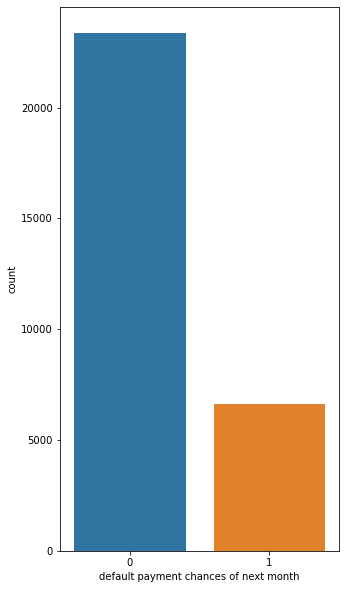

In [20]:
plt.figure(figsize=(5,10))
sns.barplot(x = pb.index,y = pb.values)
plt.xlabel('default payment chances of next month')
plt.ylabel('count')
plt.show()

probability of default payment of next month 

In [21]:
print((6636/30000)*100)

22.12


We can see that the dataset consists of 77.88% clients are not expected to default payment whereas 22.12% clients are expected to default the payment.

In [22]:
df['LIMIT_BAL'].unique()

array([  20000.,  120000.,   90000.,   50000.,  500000.,  100000.,
        140000.,  200000.,  260000.,  630000.,   70000.,  250000.,
        320000.,  360000.,  180000.,  130000.,  450000.,   60000.,
        230000.,  160000.,  280000.,   10000.,   40000.,  210000.,
        150000.,  380000.,  310000.,  400000.,   80000.,  290000.,
        340000.,  300000.,   30000.,  240000.,  470000.,  480000.,
        350000.,  330000.,  110000.,  420000.,  170000.,  370000.,
        270000.,  220000.,  190000.,  510000.,  460000.,  440000.,
        410000.,  490000.,  390000.,  580000.,  600000.,  620000.,
        610000.,  700000.,  670000.,  680000.,  430000.,  550000.,
        540000., 1000000.,  530000.,  710000.,  560000.,  520000.,
        750000.,  640000.,   16000.,  570000.,  590000.,  660000.,
        720000.,  327680.,  740000.,  800000.,  760000.,  690000.,
        650000.,  780000.,  730000.])

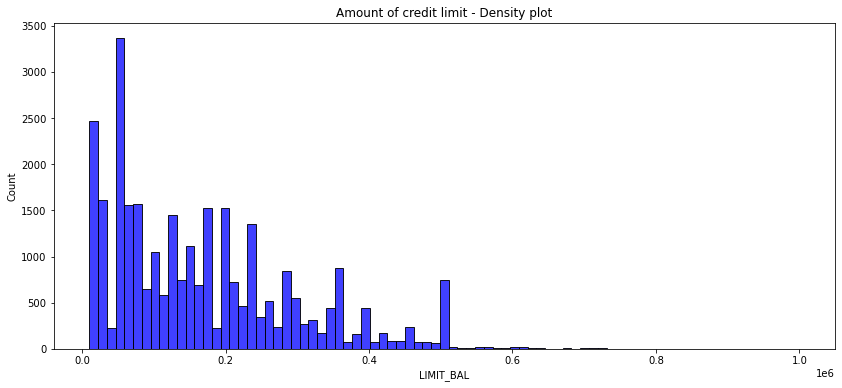

In [23]:
plt.figure(figsize=(14,6))
plt.title("Amount of credit limit - Density plot")
sns.histplot(df['LIMIT_BAL'],color="blue")
plt.show()

In [24]:
df['AGE'].unique()

array([24, 26, 34, 37, 57, 29, 23, 28, 35, 51, 41, 30, 49, 39, 40, 27, 47,
       33, 32, 54, 58, 22, 25, 31, 46, 42, 43, 45, 56, 44, 53, 38, 63, 36,
       52, 48, 55, 60, 50, 75, 61, 73, 59, 21, 67, 66, 62, 70, 72, 64, 65,
       71, 69, 68, 79, 74])

In [25]:
a = df.AGE.value_counts()

In [26]:
a

29    1605
27    1477
28    1409
30    1395
26    1256
31    1217
25    1186
34    1162
32    1158
33    1146
24    1127
35    1113
36    1108
37    1041
39     954
38     944
23     931
40     870
41     824
42     794
44     700
43     670
45     617
46     570
22     560
47     501
48     466
49     452
50     411
51     340
53     325
52     304
54     247
55     209
56     178
58     122
57     122
59      83
60      67
21      67
61      56
62      44
63      31
64      31
66      25
65      24
67      16
69      15
70      10
68       5
73       4
72       3
75       3
71       3
79       1
74       1
Name: AGE, dtype: int64

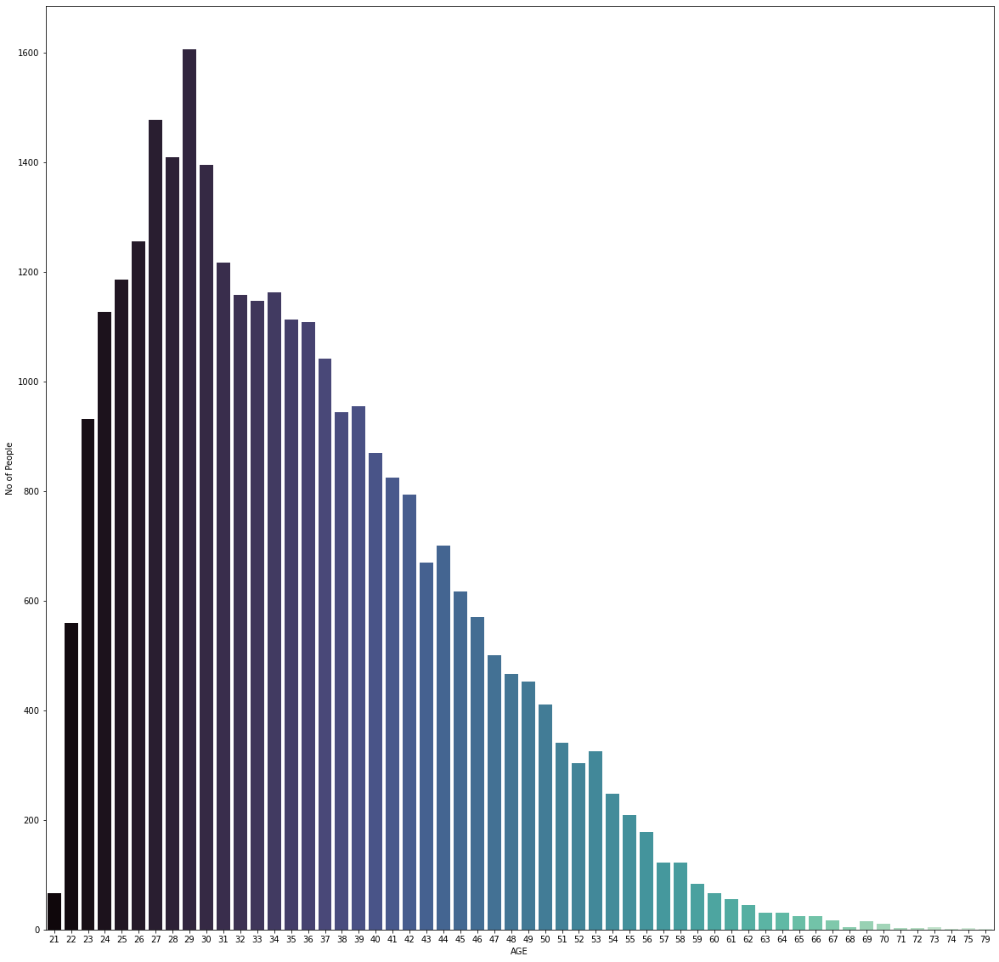

In [27]:
plt.figure(figsize=(20,20))
sns.barplot(x = a.index,y = a.values,palette= 'mako')
plt.xlabel('AGE')
plt.ylabel('No of People')
plt.show()

In [28]:
df.SEX.value_counts()

2    18112
1    11888
Name: SEX, dtype: int64

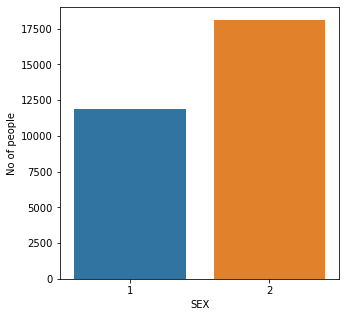

In [29]:
plt.figure(figsize=(5,5))
sns.countplot(data = df,x = 'SEX')
plt.xlabel('SEX')
plt.ylabel('No of people')
plt.show()

In [30]:
df['EDUCATION'].unique()

array([2, 1, 3, 5, 4, 6, 0])

In [31]:
df.EDUCATION.value_counts()

2    14030
1    10585
3     4917
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64

In [32]:
df['dpnm'].groupby(df['EDUCATION']).value_counts(normalize=True)

EDUCATION  dpnm
0          0       1.000000
1          0       0.807652
           1       0.192348
2          0       0.762651
           1       0.237349
3          0       0.748424
           1       0.251576
4          0       0.943089
           1       0.056911
5          0       0.935714
           1       0.064286
6          0       0.843137
           1       0.156863
Name: dpnm, dtype: float64

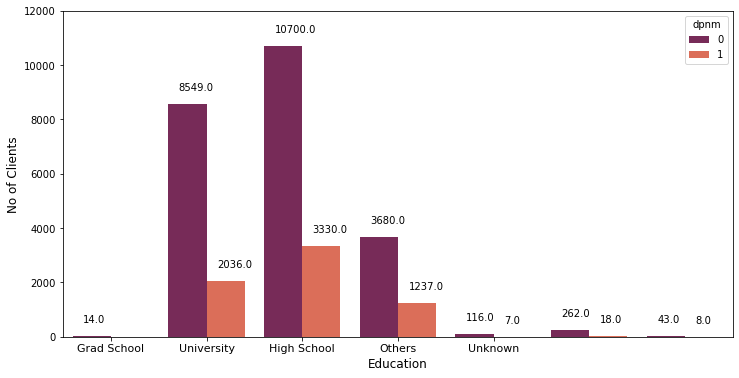

In [33]:
plt.figure(figsize=(12,6))
ax = sns.countplot(data = df,x='EDUCATION',hue='dpnm',palette='rocket')
plt.xlabel("Education", fontsize= 12)
plt.ylabel("No of Clients", fontsize= 12)
plt.ylim(0,12000)
plt.xticks([0,1,2,3,4],['Grad School','University','High School','Others','Unknown'], fontsize = 11)
for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.11, p.get_height()+500))
plt.show()

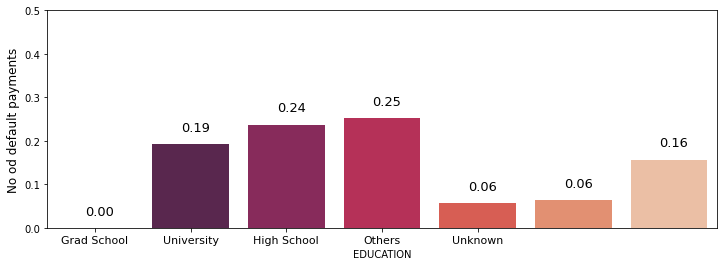

In [34]:
plt.figure(figsize=(12,4))

ax = sns.barplot(x = "EDUCATION", y = "dpnm", data = df, palette = 'rocket', ci = None)

plt.ylabel("No od default payments", fontsize= 12)
plt.ylim(0,0.5)
plt.xticks([0,1,2,3,4],['Grad School','University','High School','Others','Unknown'], fontsize = 11)

for p in ax.patches:
    ax.annotate("%.2f" %(p.get_height()), (p.get_x()+0.30, p.get_height()+0.03),fontsize=13)

plt.show()

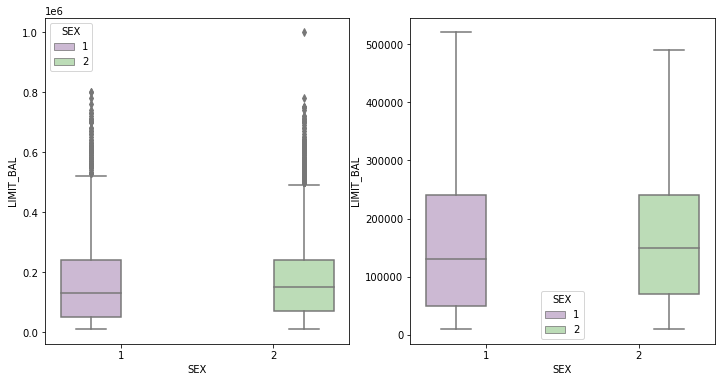

In [35]:
fig,(ax1,ax2) = plt.subplots(ncols=2,figsize=(12,6))
s = sns.boxplot(ax = ax1,x = 'SEX',y = 'LIMIT_BAL',hue='SEX',data = df,palette='PRGn',showfliers = True)
s = sns.boxplot(ax = ax2,x = 'SEX',y = 'LIMIT_BAL',hue='SEX',data = df,palette ='PRGn',showfliers = False)
plt.show()

# Martial Status

MARRIAGE: Marital status (1=married, 2=single, 3=others)

Defalut.payment.next.month renamed as dpnm
default.payment.next.month: Default payment (1=yes, 0=no)

In [36]:
df['dpnm'].unique()

array([1, 0])

In [37]:
df['MARRIAGE'].unique()

array([1, 2, 3, 0])

In [38]:
df['dpnm'].groupby(df['MARRIAGE']).value_counts()

MARRIAGE  dpnm
0         0          49
          1           5
1         0       10453
          1        3206
2         0       12623
          1        3341
3         0         239
          1          84
Name: dpnm, dtype: int64

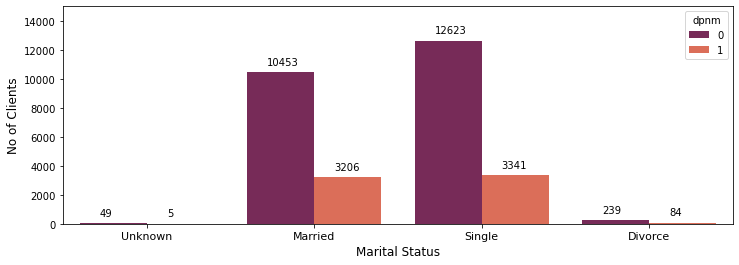

In [39]:
plt.figure(figsize=(12,4))

ax = sns.countplot(data = df, x = 'MARRIAGE', hue="dpnm", palette = 'rocket')

plt.xlabel("Marital Status", fontsize= 12)
plt.ylabel("No of Clients", fontsize= 12)
plt.ylim(0,15000)
plt.xticks([0,1,2,3],['Unknown', 'Married', 'Single', 'Divorce'], fontsize = 11)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.12, p.get_height()+500))

plt.show()

# Sex + Education/Marital Status

In [40]:
df.groupby(by = ['EDUCATION','SEX'])['dpnm'].value_counts()

EDUCATION  SEX  dpnm
0          1    0          8
           2    0          6
1          1    0       3448
                1        906
           2    0       5101
                1       1130
2          1    0       3966
                1       1408
           2    0       6734
                1       1922
3          1    0       1445
                1        545
           2    0       2235
                1        692
4          1    0         38
                1          4
           2    0         78
                1          3
5          1    0         89
                1          6
           2    0        173
                1         12
6          1    0         21
                1          4
           2    0         22
                1          4
Name: dpnm, dtype: int64

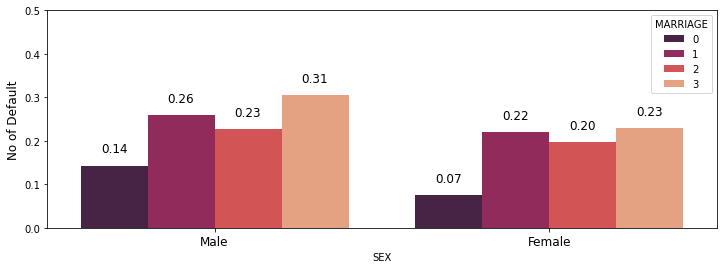

In [41]:
plt.figure(figsize=(12,4))

ax = sns.barplot(x = "SEX", y = "dpnm", hue = "MARRIAGE", data = df, palette = 'rocket', ci = None)

plt.ylabel("No of Default", fontsize= 12)
plt.ylim(0,0.5)
plt.xticks([0,1],['Male', 'Female'], fontsize = 12)

for p in ax.patches:
    ax.annotate("%.2f" %(p.get_height()), (p.get_x()+0.06, p.get_height()+0.03),fontsize=12)

plt.show()

In [42]:
df['AgeBin'] = pd.cut(df['AGE'],[20, 25, 30, 35, 40, 50, 60, 80])
print(df['AgeBin'].value_counts())

(25, 30]    7142
(40, 50]    6005
(30, 35]    5796
(35, 40]    4917
(20, 25]    3871
(50, 60]    1997
(60, 80]     272
Name: AgeBin, dtype: int64


In [43]:
df['dpnm'].groupby(df['AgeBin']).value_counts()

AgeBin    dpnm
(20, 25]  0       2839
          1       1032
(25, 30]  0       5703
          1       1439
(30, 35]  0       4670
          1       1126
(35, 40]  0       3854
          1       1063
(40, 50]  0       4606
          1       1399
(50, 60]  0       1493
          1        504
(60, 80]  0        199
          1         73
Name: dpnm, dtype: int64

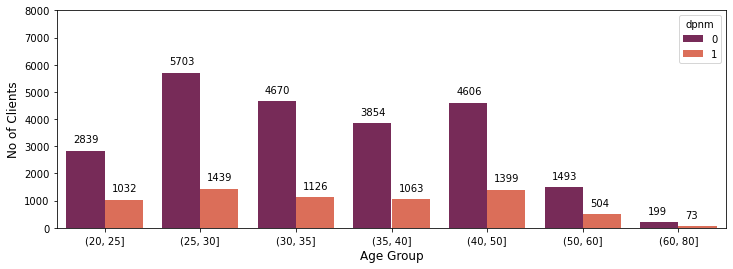

In [44]:
plt.figure(figsize=(12,4))
df['AgeBin'] = df['AgeBin'].astype('str')
AgeBin_order = ['(20, 25]', '(25, 30]', '(30, 35]', '(35, 40]', '(40, 50]', '(50, 60]', '(60, 80]']
ax = sns.countplot(data = df, x = 'AgeBin', hue="dpnm", palette = 'rocket', order = AgeBin_order)
plt.xlabel("Age Group", fontsize= 12)
plt.ylabel("No of Clients", fontsize= 12)
plt.ylim(0,8000)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.075, p.get_height()+300))

plt.show()

In [45]:
df['LimitBin'] = pd.cut(df['LIMIT_BAL'],[5000, 50000, 100000, 150000, 200000, 300000, 400000, 500000, 1100000])
print(df['LimitBin'].value_counts())

(5000, 50000]        7676
(200000, 300000]     5059
(50000, 100000]      4822
(150000, 200000]     3978
(100000, 150000]     3902
(300000, 400000]     2759
(400000, 500000]     1598
(500000, 1100000]     206
Name: LimitBin, dtype: int64


In [46]:
df['dpnm'].groupby(df['LimitBin']).value_counts()

LimitBin           dpnm
(5000, 50000]      0       5236
                   1       2440
(50000, 100000]    0       3578
                   1       1244
(100000, 150000]   0       3077
                   1        825
(150000, 200000]   0       3268
                   1        710
(200000, 300000]   0       4247
                   1        812
(300000, 400000]   0       2371
                   1        388
(400000, 500000]   0       1404
                   1        194
(500000, 1100000]  0        183
                   1         23
Name: dpnm, dtype: int64

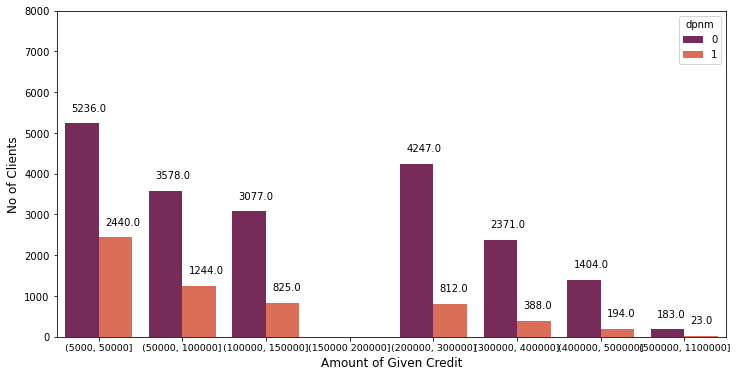

In [47]:
plt.figure(figsize=(12,6))
df['LimitBin'] = df['LimitBin'].astype('str')
LimitBin_order = ('(5000, 50000]','(50000, 100000]','(100000, 150000]','(150000 200000]',
                  '(200000, 300000]','(300000, 400000]','(400000, 500000]','(500000, 1100000]')
ax = sns.countplot(data = df,x='LimitBin',hue = 'dpnm', palette = 'rocket', order = LimitBin_order)
plt.xlabel("Amount of Given Credit", fontsize= 12)
plt.ylabel("No of Clients", fontsize= 12)
plt.ylim(0,8000)
ax.tick_params(axis="x", labelsize= 9.5)
for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.075, p.get_height()+300))

plt.show()

PAY_1: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)

PAY_2: Repayment status in August, 2005 (scale same as above)

PAY_3: Repayment status in July, 2005 (scale same as above)

PAY_4: Repayment status in June, 2005 (scale same as above)

PAY_5: Repayment status in May, 2005 (scale same as above)

PAY_6: Repayment status in April, 2005 (scale same as above)

In [48]:
print(df.PAY_1.value_counts())
print(df.PAY_2.value_counts())
print(df.PAY_3.value_counts())
print(df.PAY_4.value_counts())
print(df.PAY_5.value_counts())
print(df.PAY_6.value_counts())

 0    14737
-1     5686
 1     3688
-2     2759
 2     2667
 3      322
 4       76
 5       26
 8       19
 6       11
 7        9
Name: PAY_1, dtype: int64
 0    15730
-1     6050
 2     3927
-2     3782
 3      326
 4       99
 1       28
 5       25
 7       20
 6       12
 8        1
Name: PAY_2, dtype: int64
 0    15764
-1     5938
-2     4085
 2     3819
 3      240
 4       76
 7       27
 6       23
 5       21
 1        4
 8        3
Name: PAY_3, dtype: int64
 0    16455
-1     5687
-2     4348
 2     3159
 3      180
 4       69
 7       58
 5       35
 6        5
 1        2
 8        2
Name: PAY_4, dtype: int64
 0    16947
-1     5539
-2     4546
 2     2626
 3      178
 4       84
 7       58
 5       17
 6        4
 8        1
Name: PAY_5, dtype: int64
 0    16286
-1     5740
-2     4895
 2     2766
 3      184
 4       49
 7       46
 6       19
 5       13
 8        2
Name: PAY_6, dtype: int64


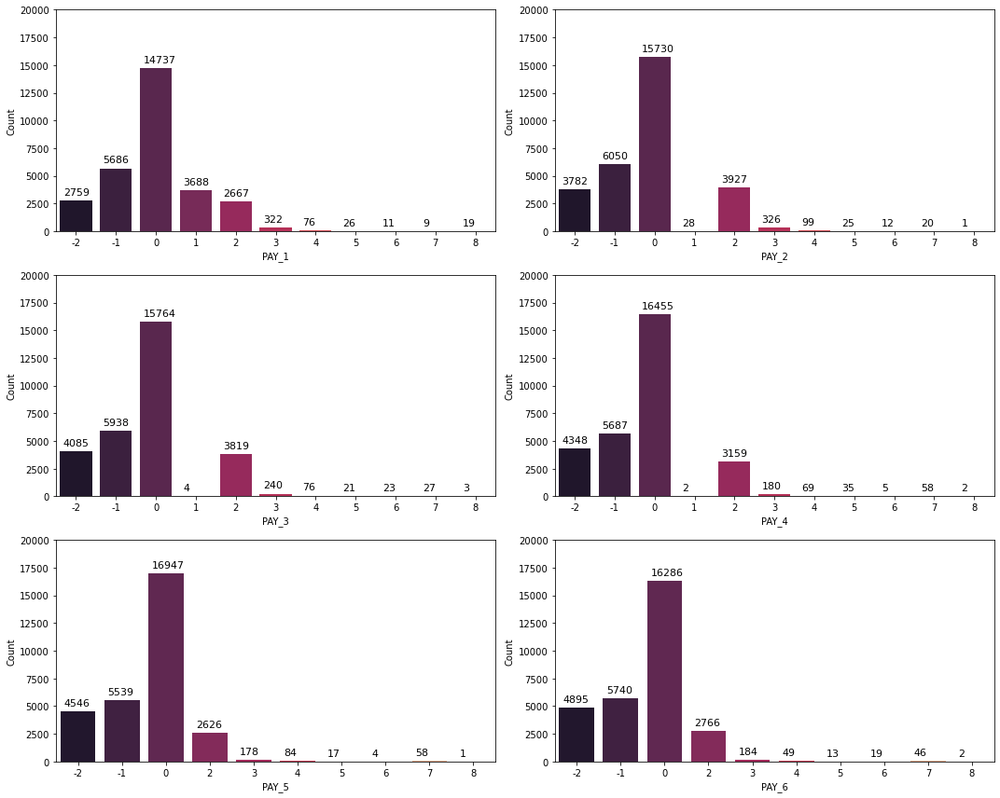

In [49]:
pay_x_fts = ['PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']
plt.figure(figsize=(15,12))

for i,col in enumerate(pay_x_fts):    
    plt.subplot(3,2,i + 1)
    ax = sns.countplot(df.loc[:,col], palette = 'rocket')
    plt.ylim(0,20000)
    plt.ylabel('Count')
    plt.tight_layout()
    
    for p in ax.patches:
        ax.annotate((p.get_height()), (p.get_x()+0.08, p.get_height()+500), fontsize = 11)

plt.show()

# Amount of Bill Statement and Previous Payment

In [50]:
a = df.BILL_AMT1.value_counts()

In [51]:
a1 = a.sort_values(ascending= False)

In [52]:
a1.iloc[:20]

 0.0       2008
 390.0      244
 780.0       76
 326.0       72
 316.0       63
 2500.0      59
 396.0       49
 2400.0      39
 416.0       29
 500.0       25
 1050.0      25
 1473.0      24
-200.0       22
-5.0         22
 1261.0      22
 836.0       21
 264.0       20
-3.0         19
 291.0       19
 600.0       18
Name: BILL_AMT1, dtype: int64

In [53]:
a1.iloc[20:]

 360.0       17
-2.0         17
-4.0         16
-1.0         16
 1000.0      16
             ..
 135841.0     1
 7808.0       1
 46795.0      1
 52514.0      1
 47929.0      1
Name: BILL_AMT1, Length: 22703, dtype: int64

In [54]:
bill_amtx_fts = ['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']

bill_amtx_bins = ['BILL_AMT1_bin', 'BILL_AMT2_bin', 'BILL_AMT3_bin', 'BILL_AMT4_bin', 'BILL_AMT5_bin', 'BILL_AMT6_bin']

for i, col in enumerate (bill_amtx_bins):
    df[col] = pd.cut(df[bill_amtx_fts[i]],[-350000,-1,0,25000, 75000, 200000, 2000000])
    print(df[col].value_counts())

(0, 25000]           12965
(25000, 75000]        7656
(75000, 200000]       5258
(-1, 0]               2008
(200000, 2000000]     1523
(-350000, -1]          590
Name: BILL_AMT1_bin, dtype: int64
(0, 25000]           12647
(25000, 75000]        7692
(75000, 200000]       5094
(-1, 0]               2506
(200000, 2000000]     1392
(-350000, -1]          669
Name: BILL_AMT2_bin, dtype: int64
(0, 25000]           12696
(25000, 75000]        7635
(75000, 200000]       4888
(-1, 0]               2870
(200000, 2000000]     1256
(-350000, -1]          655
Name: BILL_AMT3_bin, dtype: int64
(0, 25000]           13081
(25000, 75000]        7401
(75000, 200000]       4623
(-1, 0]               3195
(200000, 2000000]     1025
(-350000, -1]          675
Name: BILL_AMT4_bin, dtype: int64
(0, 25000]           13401
(25000, 75000]        7163
(75000, 200000]       4399
(-1, 0]               3506
(200000, 2000000]      876
(-350000, -1]          655
Name: BILL_AMT5_bin, dtype: int64
(0, 25000]          

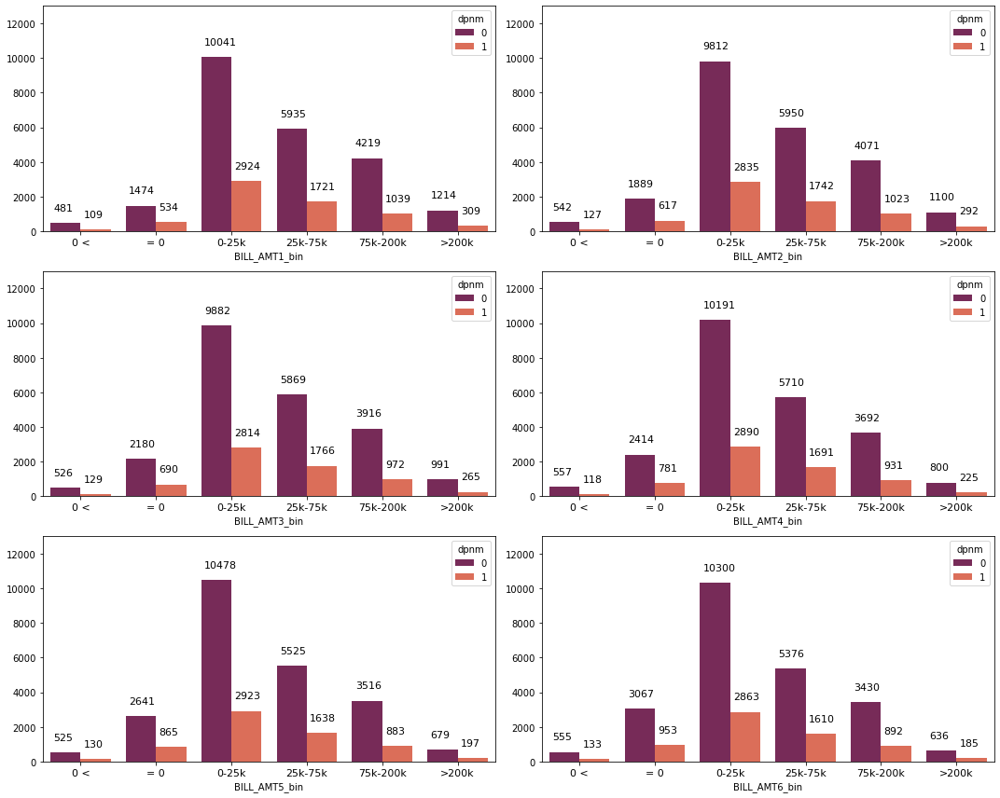

In [55]:
plt.figure(figsize=(15,12))

for i,col in enumerate(bill_amtx_bins):    
    plt.subplot(3,2,i + 1)
    ax = sns.countplot(data = df, x = col, hue="dpnm", palette = 'rocket')
    plt.ylim(0,13000)
    plt.ylabel('')
    plt.xticks([0,1,2,3,4,5],['0 <', '= 0', '0-25k', '25k-75k', '75k-200k', '>200k'], fontsize = 11)
    plt.tight_layout()

    for p in ax.patches:
        ax.annotate((p.get_height()), (p.get_x()+0.04, p.get_height()+700), fontsize = 11)    
        
plt.show()

In [56]:
pay_amtx_fts = ['PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']

pay_amtx_bins = ['PAY_AMT1_bin', 'PAY_AMT2_bin', 'PAY_AMT3_bin', 'PAY_AMT4_bin', 'PAY_AMT5_bin', 'PAY_AMT6_bin']

for i, col in enumerate (pay_amtx_bins):
    df[col] = pd.cut(df[pay_amtx_fts[i]],[-1, 0, 25000, 50000, 100000, 2000000])
    print(df[col].value_counts())

(0, 25000]           23730
(-1, 0]               5249
(25000, 50000]         550
(50000, 100000]        322
(100000, 2000000]      149
Name: PAY_AMT1_bin, dtype: int64
(0, 25000]           23569
(-1, 0]               5396
(25000, 50000]         556
(50000, 100000]        283
(100000, 2000000]      196
Name: PAY_AMT2_bin, dtype: int64
(0, 25000]           23068
(-1, 0]               5968
(25000, 50000]         514
(50000, 100000]        273
(100000, 2000000]      177
Name: PAY_AMT3_bin, dtype: int64
(0, 25000]           22641
(-1, 0]               6408
(25000, 50000]         533
(50000, 100000]        271
(100000, 2000000]      147
Name: PAY_AMT4_bin, dtype: int64
(0, 25000]           22382
(-1, 0]               6703
(25000, 50000]         493
(50000, 100000]        268
(100000, 2000000]      154
Name: PAY_AMT5_bin, dtype: int64
(0, 25000]           21785
(-1, 0]               7173
(25000, 50000]         517
(50000, 100000]        300
(100000, 2000000]      225
Name: PAY_AMT6_bin, dtype

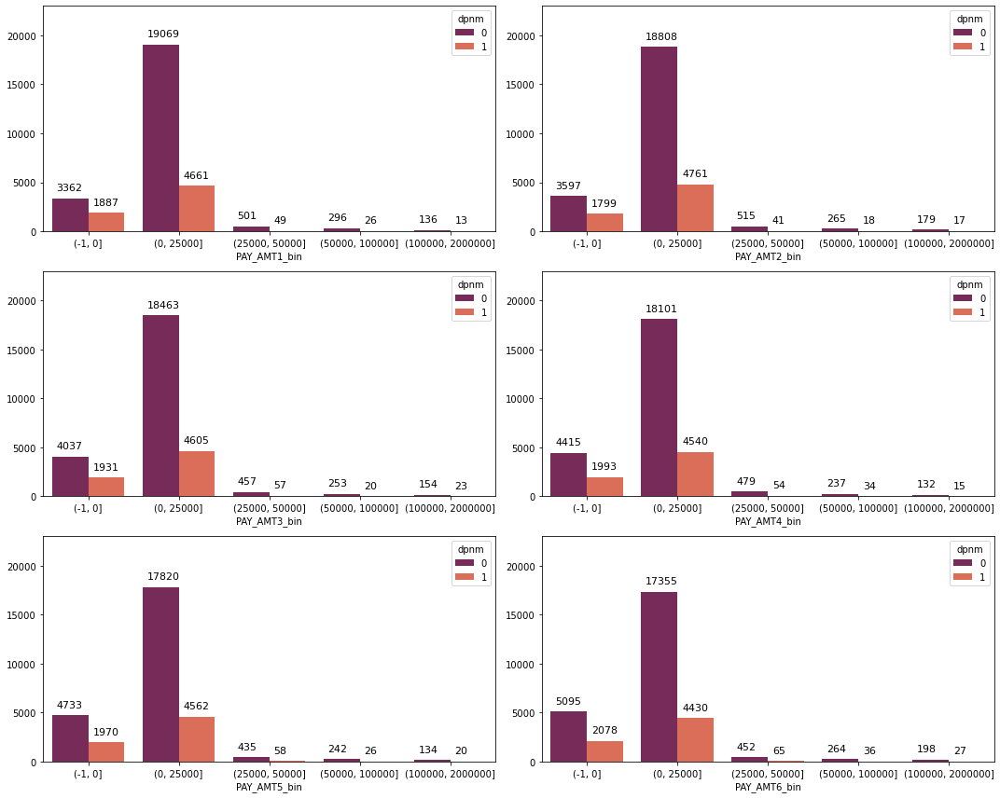

In [57]:
plt.figure(figsize=(15,12))

for i,col in enumerate(pay_amtx_bins):    
    plt.subplot(3,2,i + 1)
    ax = sns.countplot(data = df, x = col, hue="dpnm", palette = 'rocket')
    plt.ylim(0,23000)
    plt.ylabel('')
    plt.tight_layout()
    
    for p in ax.patches:
        ax.annotate((p.get_height()), (p.get_x()+0.05, p.get_height()+800), fontsize=11)    
plt.show()

In [58]:
df

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT3_bin,BILL_AMT4_bin,BILL_AMT5_bin,BILL_AMT6_bin,PAY_AMT1_bin,PAY_AMT2_bin,PAY_AMT3_bin,PAY_AMT4_bin,PAY_AMT5_bin,PAY_AMT6_bin
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,"(0, 25000]","(-1, 0]","(-1, 0]","(-1, 0]","(-1, 0]","(0, 25000]","(-1, 0]","(-1, 0]","(-1, 0]","(-1, 0]"
1,2,120000.0,2,2,2,26,-1,2,0,0,...,"(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(-1, 0]","(0, 25000]","(0, 25000]","(0, 25000]","(-1, 0]","(0, 25000]"
2,3,90000.0,2,2,2,34,0,0,0,0,...,"(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]"
3,4,50000.0,2,2,1,37,0,0,0,0,...,"(25000, 75000]","(25000, 75000]","(25000, 75000]","(25000, 75000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]"
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,"(25000, 75000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(25000, 50000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000.0,1,3,1,39,0,0,0,0,...,"(200000, 2000000]","(75000, 200000]","(25000, 75000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]"
29996,29997,150000.0,1,3,2,43,-1,-1,-1,-1,...,"(0, 25000]","(0, 25000]","(0, 25000]","(-1, 0]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(-1, 0]","(-1, 0]"
29997,29998,30000.0,1,2,2,37,4,3,2,-1,...,"(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]","(-1, 0]","(-1, 0]","(0, 25000]","(0, 25000]","(0, 25000]","(0, 25000]"
29998,29999,80000.0,1,3,1,41,1,-1,0,0,...,"(75000, 200000]","(25000, 75000]","(0, 25000]","(25000, 75000]","(50000, 100000]","(0, 25000]","(0, 25000]","(0, 25000]","(50000, 100000]","(0, 25000]"


In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 39 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   ID             30000 non-null  int64   
 1   LIMIT_BAL      30000 non-null  float64 
 2   SEX            30000 non-null  int64   
 3   EDUCATION      30000 non-null  int64   
 4   MARRIAGE       30000 non-null  int64   
 5   AGE            30000 non-null  int64   
 6   PAY_1          30000 non-null  int64   
 7   PAY_2          30000 non-null  int64   
 8   PAY_3          30000 non-null  int64   
 9   PAY_4          30000 non-null  int64   
 10  PAY_5          30000 non-null  int64   
 11  PAY_6          30000 non-null  int64   
 12  BILL_AMT1      30000 non-null  float64 
 13  BILL_AMT2      30000 non-null  float64 
 14  BILL_AMT3      30000 non-null  float64 
 15  BILL_AMT4      30000 non-null  float64 
 16  BILL_AMT5      30000 non-null  float64 
 17  BILL_AMT6      30000 non-null  

In [60]:
df.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_1',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'dpnm',
       'AgeBin', 'LimitBin', 'BILL_AMT1_bin', 'BILL_AMT2_bin', 'BILL_AMT3_bin',
       'BILL_AMT4_bin', 'BILL_AMT5_bin', 'BILL_AMT6_bin', 'PAY_AMT1_bin',
       'PAY_AMT2_bin', 'PAY_AMT3_bin', 'PAY_AMT4_bin', 'PAY_AMT5_bin',
       'PAY_AMT6_bin'],
      dtype='object')

In [61]:
x = df.drop(columns=['AgeBin', 'LimitBin', 'BILL_AMT1_bin', 'BILL_AMT2_bin', 'BILL_AMT3_bin',
       'BILL_AMT4_bin', 'BILL_AMT5_bin', 'BILL_AMT6_bin', 'PAY_AMT1_bin',
       'PAY_AMT2_bin', 'PAY_AMT3_bin', 'PAY_AMT4_bin', 'PAY_AMT5_bin',
       'PAY_AMT6_bin','dpnm','ID'])

In [62]:
x

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000.0,2,2,2,26,-1,2,0,0,0,...,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
2,90000.0,2,2,2,34,0,0,0,0,0,...,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0
3,50000.0,2,2,1,37,0,0,0,0,0,...,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000.0,1,3,1,39,0,0,0,0,0,...,208365.0,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0
29996,150000.0,1,3,2,43,-1,-1,-1,-1,0,...,3502.0,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0
29997,30000.0,1,2,2,37,4,3,2,-1,0,...,2758.0,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0
29998,80000.0,1,3,1,41,1,-1,0,0,0,...,76304.0,52774.0,11855.0,48944.0,85900.0,3409.0,1178.0,1926.0,52964.0,1804.0


In [63]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 23 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   LIMIT_BAL  30000 non-null  float64
 1   SEX        30000 non-null  int64  
 2   EDUCATION  30000 non-null  int64  
 3   MARRIAGE   30000 non-null  int64  
 4   AGE        30000 non-null  int64  
 5   PAY_1      30000 non-null  int64  
 6   PAY_2      30000 non-null  int64  
 7   PAY_3      30000 non-null  int64  
 8   PAY_4      30000 non-null  int64  
 9   PAY_5      30000 non-null  int64  
 10  PAY_6      30000 non-null  int64  
 11  BILL_AMT1  30000 non-null  float64
 12  BILL_AMT2  30000 non-null  float64
 13  BILL_AMT3  30000 non-null  float64
 14  BILL_AMT4  30000 non-null  float64
 15  BILL_AMT5  30000 non-null  float64
 16  BILL_AMT6  30000 non-null  float64
 17  PAY_AMT1   30000 non-null  float64
 18  PAY_AMT2   30000 non-null  float64
 19  PAY_AMT3   30000 non-null  float64
 20  PAY_AM

In [64]:
y = df.dpnm

In [65]:
y

0        1
1        1
2        0
3        0
4        0
        ..
29995    0
29996    0
29997    1
29998    1
29999    1
Name: dpnm, Length: 30000, dtype: int64

In [115]:
train_file = pd.DataFrame(x_train,y_train)

In [116]:
train_file

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
dpnm,,,,,,,,,,,,,,,,,,,,,
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000.0,2,2,2,26,-1,2,0,0,0,...,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000.0,2,2,2,26,-1,2,0,0,0,...,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1,120000.0,2,2,2,26,-1,2,0,0,0,...,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000.0,2,2,2,26,-1,2,0,0,0,...,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0


In [119]:
df.to_csv("train_file.csv")

In [121]:
x_test

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
22041,90000.0,2,3,1,25,0,0,0,0,0,...,17566.0,8718.0,6432.0,2655.0,1619.0,1266.0,1048.0,1032.0,1655.0,0.0
1505,350000.0,1,1,1,70,0,0,0,0,0,...,64839.0,57583.0,45554.0,37063.0,3371.0,2089.0,3008.0,1300.0,1500.0,1372.0
25528,420000.0,2,1,1,32,-1,-1,-2,-2,-2,...,0.0,0.0,20.0,0.0,358.0,0.0,0.0,20.0,0.0,0.0
20475,210000.0,1,1,2,27,1,-1,-1,-1,-1,...,0.0,582.0,291.0,1027.0,582.0,0.0,582.0,291.0,1027.0,291.0
698,280000.0,1,1,1,41,-2,-2,-2,-2,-1,...,51500.0,35752.0,3955.0,13969.0,41346.0,52110.0,35752.0,3955.0,13939.0,4437.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5230,20000.0,1,2,2,24,0,0,0,0,0,...,19026.0,19406.0,18258.0,18694.0,1318.0,1290.0,670.0,663.0,740.0,536.0
26659,50000.0,1,2,2,25,0,0,2,2,-1,...,16012.0,14228.0,19546.0,19473.0,2800.0,0.0,1644.0,63965.0,705.0,798.0
13108,240000.0,2,2,1,39,-1,-1,-1,0,0,...,68105.0,95615.0,123931.0,151559.0,2831.0,68116.0,30800.0,30000.0,30000.0,10000.0
126,200000.0,1,3,2,52,0,0,0,0,0,...,98951.0,100914.0,103146.0,104993.0,3568.0,3585.0,3602.0,3848.0,3669.0,3784.0


In [122]:
df.to_csv("test_file.csv")

In [66]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, accuracy_score,confusion_matrix,roc_curve, make_scorer
from sklearn import metrics
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

In [67]:
x_train,x_test,y_train,y_test = train_test_split(x,y,train_size=0.75,test_size=0.25)

In [68]:
log_model = LogisticRegression()

In [69]:
log_model.fit(x_train,y_train)

LogisticRegression()

In [70]:
ypred = log_model.predict(x_test)

In [71]:
accuracy = accuracy_score(y_test,ypred)

In [72]:
accuracy

0.7797333333333333

In [73]:
acc = log_model.score(x_train,y_train)
acc1 = log_model.score(x_test,y_test)
print(f'Training dataset accuracy of the model is {acc}')
print(f'Test dataset accuracy of the model is {acc1}')

Training dataset accuracy of the model is 0.7783555555555556
Test dataset accuracy of the model is 0.7797333333333333


In [74]:
ytrain_pred = log_model.predict_proba(x_train)
ytest_pred = log_model.predict_proba(x_test)

In [75]:
ytrain_pred = log_model.predict_proba(x_train)
print('Logistic train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred[:,1])))
ytest_pred = log_model.predict_proba(x_test)
print('Logistic test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred[:,1])))

Logistic train roc-auc: 0.6551938601989239
Logistic test roc-auc: 0.6508819939401653


# RandomForestClassifier

In [76]:
rf_model = RandomForestClassifier()
rf_model.fit(x_train,y_train)
rf_pred = rf_model.predict(x_test)

In [77]:
rf_model.score(x_train,y_train)

0.9993777777777778

In [78]:
print("Test Accuracy: ",accuracy_score(y_test, rf_pred))

Test Accuracy:  0.8150666666666667


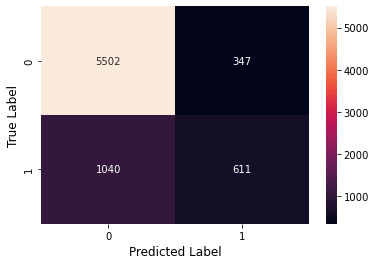

In [79]:
rf_confusion_matrix = confusion_matrix(y_test, rf_pred)
sns.heatmap(rf_confusion_matrix, annot=True, fmt="d")

plt.xlabel("Predicted Label", fontsize= 12)
plt.ylabel("True Label", fontsize= 12)

plt.show()

In [80]:
print(metrics.classification_report(y_test, rf_pred, labels = [0, 1]))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      5849
           1       0.64      0.37      0.47      1651

    accuracy                           0.82      7500
   macro avg       0.74      0.66      0.68      7500
weighted avg       0.80      0.82      0.80      7500



In [81]:
ytrain_pred1 = rf_model.predict_proba(x_train)
print('RF train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred1[:,1])))
ytest_pred1 = rf_model.predict_proba(x_test)
print('RF test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred1[:,1])))

RF train roc-auc: 0.9999934774348739
RF test roc-auc: 0.7647801282819315


ROC_AUC:  0.7647801282819315


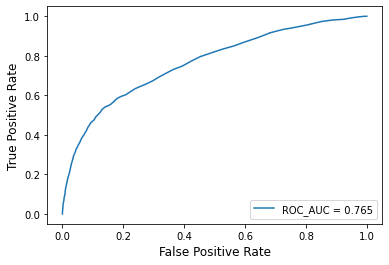

In [82]:
rf_pred_proba = rf_model.predict_proba(x_test)[:,1]

rf_roc_auc = metrics.roc_auc_score(y_test, rf_pred_proba)
print('ROC_AUC: ', rf_roc_auc)

rf_fpr, rf_tpr, thresholds = metrics.roc_curve(y_test, rf_pred_proba)

plt.plot(rf_fpr,rf_tpr, label = 'ROC_AUC = %0.3f' % rf_roc_auc)

plt.xlabel("False Positive Rate", fontsize= 12)
plt.ylabel("True Positive Rate", fontsize= 12)
plt.legend(loc="lower right")

plt.show()

In [83]:
param_grid1 = {'max_depth' : range(2,4,1),
               'criterion' : ['gini','entropy'],
               'max_features' : ['auto','log2'],
               'n_estimators' : [10,50,100,150,200]
              }

In [84]:
rf_grid_tree = GridSearchCV(RandomForestClassifier(), param_grid1, cv = 5, scoring= 'accuracy')

In [85]:
rf_grid_tree

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(2, 4),
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [10, 50, 100, 150, 200]},
             scoring='accuracy')

In [86]:
rf_grid_tree.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(2, 4),
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [10, 50, 100, 150, 200]},
             scoring='accuracy')

In [87]:
print(rf_grid_tree.best_estimator_)

RandomForestClassifier(max_depth=3, n_estimators=200)


In [88]:
print(np.abs(rf_grid_tree.best_score_))

0.8101333333333333


In [89]:
rf_model1 = RandomForestClassifier(max_depth=3, n_estimators=150)
rf_model1.fit(x_train,y_train)
rf_pred1 = rf_model1.predict(x_test)

In [90]:
accuracy_score(y_test,rf_pred1)

0.8101333333333334

In [91]:
rf_model1.score(x_train,y_train)

0.8098666666666666

In [92]:
rf_con = confusion_matrix(y_test,rf_pred1)
rf_con

array([[5657,  192],
       [1232,  419]])

<AxesSubplot:>

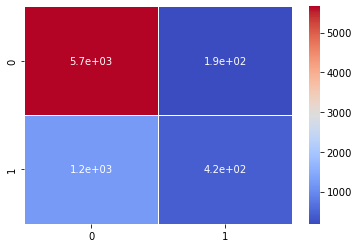

In [93]:
sns.heatmap(rf_con,annot= True,linewidths=1,cmap='coolwarm')

In [94]:
print(metrics.classification_report(y_test,rf_pred))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      5849
           1       0.64      0.37      0.47      1651

    accuracy                           0.82      7500
   macro avg       0.74      0.66      0.68      7500
weighted avg       0.80      0.82      0.80      7500



# DecisionTreeClassifier

In [95]:
dt_model = DecisionTreeClassifier()

In [96]:
dt_model.fit(x_train,y_train)

DecisionTreeClassifier()

In [97]:
dt_pred = dt_model.predict(x_test)
dt_pred

array([0, 0, 0, ..., 0, 0, 0])

In [98]:
accuracy_score(y_test,dt_pred)

0.7332

In [99]:
dt_model.score(x_train,y_train)

0.9993777777777778

In [100]:
from sklearn.model_selection import GridSearchCV

In [101]:
param_grid = {'max_depth': np.arange(3, 10),
             'criterion' : ['gini','entropy'],
             'max_leaf_nodes': [5,10,20,100],
             'min_samples_split': [2, 5, 10, 20,30,40]}
grid_tree = GridSearchCV(DecisionTreeClassifier(), param_grid, cv = 5, scoring= 'accuracy')

In [102]:
grid_tree

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': array([3, 4, 5, 6, 7, 8, 9]),
                         'max_leaf_nodes': [5, 10, 20, 100],
                         'min_samples_split': [2, 5, 10, 20, 30, 40]},
             scoring='accuracy')

In [103]:
grid_tree.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': array([3, 4, 5, 6, 7, 8, 9]),
                         'max_leaf_nodes': [5, 10, 20, 100],
                         'min_samples_split': [2, 5, 10, 20, 30, 40]},
             scoring='accuracy')

In [104]:
print(grid_tree.best_estimator_)

DecisionTreeClassifier(max_depth=4, max_leaf_nodes=10)


In [105]:
print(np.abs(grid_tree.best_score_))

0.821288888888889


In [106]:
dt_model1 = DecisionTreeClassifier(max_depth=3, max_leaf_nodes=10)
dt_model1.fit(x_train,y_train)
dtpred = dt_model1.predict(x_test)

In [107]:
dt_model1.score(x_train,y_train)

0.8225777777777777

In [108]:
accuracy_score(y_test,dtpred)

0.8192

In [109]:
dt_con = confusion_matrix(y_test,dtpred)
dt_con

array([[5542,  307],
       [1049,  602]])

<AxesSubplot:>

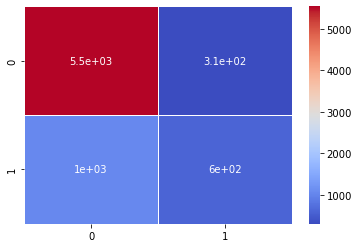

In [110]:
sns.heatmap(dt_con,annot= True,linewidths=1,cmap='coolwarm')

In [111]:
print(metrics.classification_report(y_test,dtpred))

              precision    recall  f1-score   support

           0       0.84      0.95      0.89      5849
           1       0.66      0.36      0.47      1651

    accuracy                           0.82      7500
   macro avg       0.75      0.66      0.68      7500
weighted avg       0.80      0.82      0.80      7500



In [123]:
filename = 'finalized_model.sav'
pickle.dump(log_model, open(filename, 'wb'))
filename1 = 'finalized_model1.sav'
pickle.dump(rf_model1, open(filename1, 'wb'))
filename3 = 'finalized_mode4.sav'
pickle.dump(dt_model1, open(filename3, 'wb'))

In [ ]:
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
import graphviz

In [ ]:
feature_name = list(x.columns)

In [ ]:
dot_data = export_graphviz(dt_model1,feature_names = feature_name,rounded = True,filled = True)
# Draw graph
graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("myTree1.png")
# Show graph
Image(graph.create_png())

In [ ]:
x1 = 